In [25]:
import pandas as pd
from wordcloud import WordCloud
import re
import string
import matplotlib.pyplot as plt
import nltk


from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import MultinomialNB
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')

from nltk.corpus import stopwords
from nltk.stem.snowball import FrenchStemmer
from nltk.stem import WordNetLemmatizer
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler
from imblearn.over_sampling import SMOTE

from sklearn.metrics import classification_report
from sklearn.utils import class_weight
import numpy as np

from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.metrics import make_scorer, accuracy_score, f1_score, roc_auc_score


[nltk_data] Downloading package punkt to /home/anyes/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /home/anyes/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to /home/anyes/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


# Chargement des données

In [5]:
df = pd.read_csv('Scrapped_Data/Data_APEC_all/all_data_V1_cleaned.csv')
df

,entreprise,type_contrat,date_publication,date_mise_a_jour,salaire,prise_de_poste,experience,metier,statut_du_poste,zone_de_deplacement,...,profil_recherche,langues,savoir_etre,savoir_faire,descriptif_entreprise,nombre_posts,duree,ville,code_postal,departement
0,MICHAEL PAGE INTERNATIONAL FRANCE,CDI,2024-02-29,2024-02-29,40.0,Dès que possible,0,Développeur,Cadre du secteur privé,Pas de déplacement,...,"De formation supérieure en informatique, vous ...",Aucune langue attendue,"['Autonomie', ""Capacité d'analyse"", 'Capacité ...","['Application Web', 'Développement web', 'Info...",Notre client est un éditeur de logiciels dans ...,1,NaN,Aix-en-Provence,13,Bouches-du-Rhône
1,Charlotte Drahy sas,CDI,2024-01-17,2024-03-15,40.0,Dès que possible,5,Développeur,Cadre du secteur privé,Nationale,...,Les compétences requises sont :\nProgrammation...,"Anglais, Français","[""Esprit d'équipe"", 'Motivation', 'Rigueur']","['Analyse des besoins', 'Analyse fonctionnelle...","""Charlotte Drahy sas"" est une société de conse...",1,NaN,Aubagne,13,Bouches-du-Rhône
2,LOEMA,CDI,2024-02-22,2024-02-22,47.5,Dès que possible,4,Développeur,Cadre du secteur privé,Pas de déplacement,...,Vous avez une expérience en : \n- Programma...,Aucune langue attendue,"['Curiosité', 'Goût du challenge']","['ASP.NET', 'Bootstrap Protocol', 'C sharp', '...",Situé au cœur même de la ville de Marseille no...,1,NaN,Marseille,13,Bouches-du-Rhône
3,CELAD,CDI,2024-02-29,2024-02-29,36.0,Dès que possible,1,Développeur,Cadre du secteur privé,Pas de déplacement,...,"Idéalement ingénieur de formation, vous justif...",Aucune langue attendue,"['Autonomie', 'Force de proposition', 'Qualité...","['Framework', 'JavaScript', 'ReactJS', 'TypeSc...","Issu du monde bancaire, #CELAD a été créée en ...",1,NaN,Aix-en-Provence,13,Bouches-du-Rhône
4,EASY PARTNER,CDI,2024-03-01,2024-03-01,40.0,Dès que possible,3,Développeur,Cadre du secteur privé,Pas de déplacement,...,Profil recherché\nNous recherchons un profil a...,Aucune langue attendue,"['Ambition', 'Autonomie', 'Bienveillance', 'Ca...","['Nuxt', 'Vue.js', 'Développement web', 'React...",Easy Partner est un Cabinet de recrutement dig...,1,NaN,Aix-en-Provence,13,Bouches-du-Rhône
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8037,Seyos,CDI,2024-03-15,2024-03-15,52.5,Dès que possible,5,Business developer,Cadre du secteur privé,Pas de déplacement,...,Profil recherché :\nVous avez une expérience s...,Aucune langue attendue,"['Force de proposition', 'Proactivité']","['Manutention', 'Automatisme', 'Cahier des cha...",Seyos est un cabinet de recrutement spécialisé...,1,NaN,Tonneins,47,Lot-et-Garonne
8038,LES COLETTES,CDI,2024-03-12,2024-03-12,NaN,Dès que possible,2,Ingénieur test et recettes,Cadre du secteur privé,Pas de déplacement,...,"Issu(e) d'une formation en informatique, idéal...",Aucune langue attendue,"[""Esprit d'équipe""]","['Cloud', 'Jira', 'SAAS', 'Algorithme', 'Autom...",Editeur de logiciels français multi-sectoriel ...,1,NaN,Villeneuve-sur-Lot,47,Lot-et-Garonne
8039,Armée de l'Air et de l'Espace,CDD,2024-02-21,2024-02-21,34.0,Dès que possible,0,Consultant en cybersécurité,Cadre du secteur public / Armées,Nationale,...,"Jeune diplômé, avec ou sans expérience profess...",Anglais,"[""Capacité d'adaptation"", 'Capacité de communi...","['Analyse des risques', 'Gestion de projet', '...",L’armée de l’Air et de l’Espace a pour mission...,1,de 5 mois,Saint-Dizier,52,Haute-Marne
8040,Armée de l'Air et de l'Espace,CDD,2024-02-16,2024-02-16,22.5,Dès que possible,0,Responsable sécurité informatique,Cadre du secteur public / Armées,Nationale,...,"Diplômé, avec ou sans expérience professionnel...",Anglais,"[""Capacité d'adaptation"", 'Capacité de communi...","['Analyse des risques', 'Gestion de projet', '...",L’armée de l’Air et de l’Espace a pour mission...,1,de 5 mois,Saint-Dizier,52,Haute-Marne


# Analyse de la colonne savoir faire

In [6]:
df_filter = df [['metier' , 'savoir_faire']]
df_grouped = df_filter.groupby('metier').agg(lambda col: ' '.join(col)).reset_index()
df_grouped

,metier,savoir_faire
0,Administrateur data center,"['Antivirus', 'Centre de traitement de données..."
1,Administrateur de bases de données,"['Amélioration continue', 'Base de données', '..."
2,Administrateur réseaux,"['Bureautique', 'Carte électronique', 'HSM', '..."
3,Administrateur système,"['Microsoft Windows', 'Amazon Web Services', '..."
4,Analyste financier,"['Budget prévisionnel', 'Comptabilité', 'Compt..."
5,Architecte Big Data,"['Apprentissage automatique', 'Architecture', ..."
6,Architecte développement,"['Amazon Web Services', 'Architecture logiciel..."
7,Architecte infrastructures,"['Accompagnement au changement', 'Accompagneme..."
8,Architecte réseaux,"['Border Gateway Protocol', 'Certification Jun..."
9,Architecte système,"['Extract Transform Load', 'Python', 'Scala', ..."


## Définition de quelques fonction de nettoyage

In [7]:
def remove_ponctuation(sentence):
    punc = string.punctuation
    punc += '\n\r\t'
    sentence = sentence.translate(str.maketrans(punc, ' ' * len(punc)))
    sentence = re.sub('( )+', ' ', sentence)  # Supprimer les espaces en trop
    return sentence

def remove_numbers(sentence):
    return re.sub('[0-9]+', '', sentence)

def remove_stopwords_Fr(sentence):
    stop_words = set(stopwords.words('french'))
    tokens = nltk.word_tokenize(sentence)
    filtered_sentence = [word.lower()  for word in tokens if word.lower() not in stop_words]
    return " ".join(filtered_sentence)

def stemming_Fr(sentence):
    stemmer = FrenchStemmer()
    tokens = nltk.word_tokenize(sentence)
    stemmed_tokens = [stemmer.stem(token) for token in tokens]
    stemmed_text = " ".join(stemmed_tokens)
    return stemmed_text

def lemmatization(sentence):
    lemmatizer = WordNetLemmatizer()
    tokens = nltk.word_tokenize(sentence)
    sentence_lemmatized = []
    for word in tokens:
        sentence_lemmatized.append(lemmatizer.lemmatize(word))
    return " ".join(sentence_lemmatized)

## Nettoyage de la colonne savoir_faire

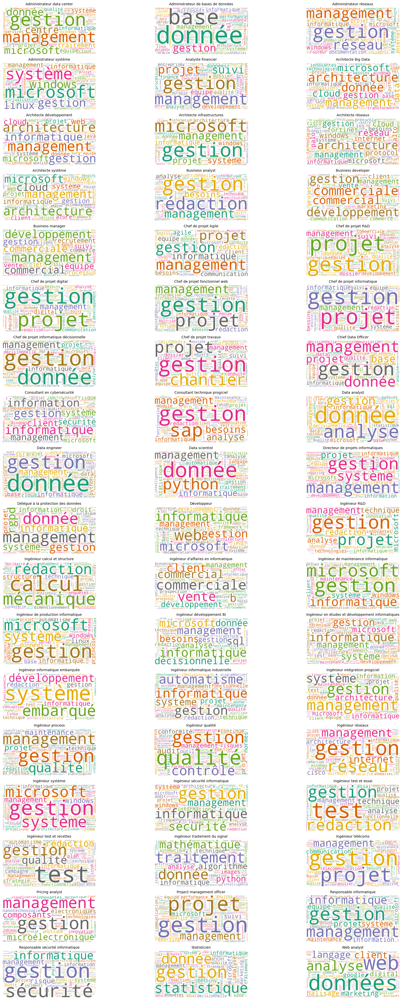

In [ ]:
wordcloud = WordCloud(background_color="white", colormap="Dark2",
             random_state=42, collocations = False, width=1600, height=800)
i = 0
fig = plt.figure(figsize=(20, 40))

for i, metier in enumerate(df_grouped["metier"].unique(), 1):
    # Extraction du texte pour le métier actuel
    text = df_grouped.loc[df_grouped["metier"] == metier, "savoir_faire"].iloc[0]

    # Nettoyage du texte
    text_cleaned = remove_stopwords_Fr(remove_numbers(remove_ponctuation(text)))

    # Génération du nuage de mots
    wordcloud.generate(text_cleaned)

    # Ajout d'un sous-graphique à la figure
    ax = fig.add_subplot(18, 3, i)  # Utilisez 9 lignes et 3 colonnes
    ax.imshow(wordcloud, interpolation="bilinear")
    ax.set_title(str(metier), size=10)
    ax.axis("off")

# Ajustement de l'espacement entre les sous-graphiques
plt.tight_layout()

# Analyse de la colonne descriptif poste

In [ ]:
df_filter2 = df [['metier' , 'descriptif_poste']]
df_grouped2 = df_filter2.groupby('metier').agg(lambda col: ' '.join(col)).reset_index()
df_grouped2

,metier,descriptif_poste
0,Administrateur data center,Descriptif du poste : Vous aurez pour missions...
1,Administrateur de bases de données,Nous recherchons un DBA Oracle (F/H) pour inté...
2,Administrateur réseaux,\nVous rejoindrez l'équipe Protection des R...
3,Administrateur système,"Notre client, société d'infogérance à taille h..."
4,Analyste financier,Vos missions :\nAccompagner de manière privilé...
5,Architecte Big Data,"Contexte En pleine transformation digitale, le..."
6,Architecte développement,"Rattaché(e) au Responsable Technique, vous au..."
7,Architecte infrastructures,Missions\n\nPour répondre aux besoins de nos c...
8,Architecte réseaux,Aix-Marseille Université (AMU) et ses partenai...
9,Architecte système,Envie de rejoindre une entreprise innovante en...


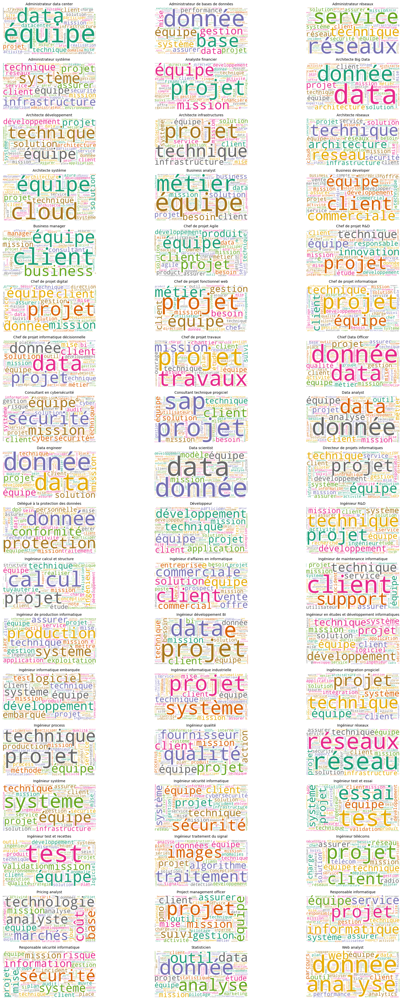

In [ ]:
wordcloud = WordCloud(background_color="white", colormap="Dark2",
             random_state=42, collocations = False, width=1600, height=800)
i = 0
fig = plt.figure(figsize=(20, 40))

for i, metier in enumerate(df_grouped2["metier"].unique(), 1):
    # Extraction du texte pour le métier actuel
    text = df_grouped2.loc[df_grouped2["metier"] == metier, "descriptif_poste"].iloc[0]

    # Nettoyage du texte
    text_cleaned = remove_stopwords_Fr(remove_numbers(remove_ponctuation(text)))

    # Génération du nuage de mots
    wordcloud.generate(text_cleaned)

    # Ajout d'un sous-graphique à la figure
    ax = fig.add_subplot(18, 3, i)  # Utilisez 9 lignes et 3 colonnes
    ax.imshow(wordcloud, interpolation="bilinear")
    ax.set_title(str(metier), size=10)
    ax.axis("off")

# Ajustement de l'espacement entre les sous-graphiques
plt.tight_layout()

## Ajout d'une liste de mots aux stopwords

Aprés avoir visualiser les wordcloud on remarque que il y a certain mot qui se répéte dans tout les types de métier comme ['informatique', 'gestion', 'management', 'projet', 'équipe', 'mission', 'client']

In [8]:
def remove_stopwords_Fr_2 (sentence):
    stop_words = set(stopwords.words('french'))
    additional_stop_words = {'informatique', 'gestion', 'management', 'projet', 'équipe', 'mission', 'client'}
    stop_words.update(additional_stop_words)
    tokens = nltk.word_tokenize(sentence)
    filtered_sentence = [word.lower()  for word in tokens if word.lower() not in stop_words]
    return " ".join(filtered_sentence)

### Savoir faire

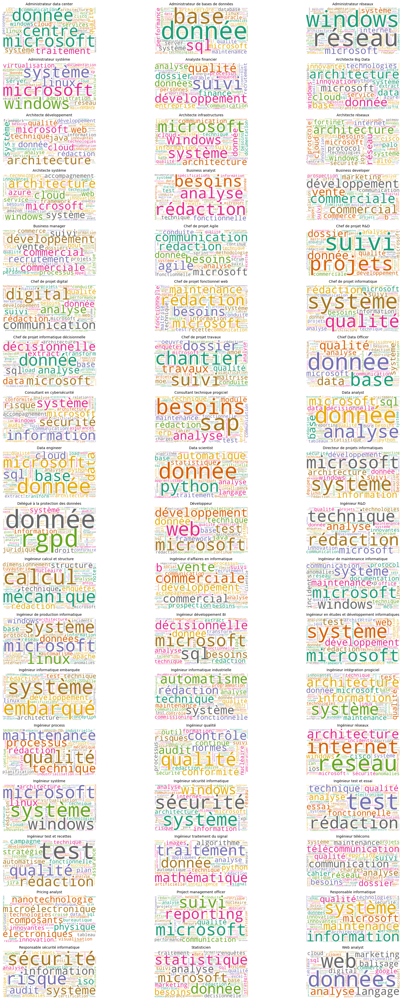

In [9]:
wordcloud = WordCloud(background_color="white", colormap="Dark2",
             random_state=42, collocations = False, width=1600, height=800)
i = 0
fig = plt.figure(figsize=(20, 40))

for i, metier in enumerate(df_grouped["metier"].unique(), 1):
    # Extraction du texte pour le métier actuel
    text = df_grouped.loc[df_grouped["metier"] == metier, "savoir_faire"].iloc[0]

    # Nettoyage du texte
    text_cleaned = remove_stopwords_Fr_2(remove_numbers(remove_ponctuation(text)))

    # Génération du nuage de mots
    wordcloud.generate(text_cleaned)

    # Ajout d'un sous-graphique à la figure
    ax = fig.add_subplot(18, 3, i)  # Utilisez 9 lignes et 3 colonnes
    ax.imshow(wordcloud, interpolation="bilinear")
    ax.set_title(str(metier), size=10)
    ax.axis("off")

# Ajustement de l'espacement entre les sous-graphiques
plt.tight_layout()

### Descriptif poste

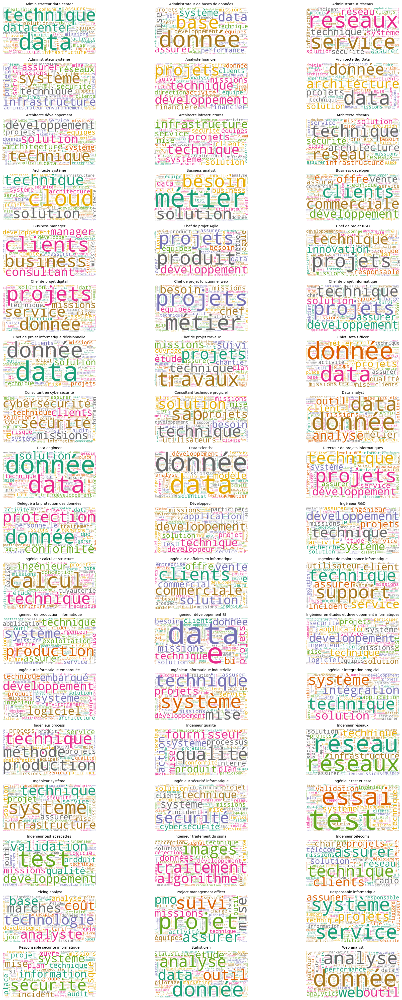

In [10]:
wordcloud = WordCloud(background_color="white", colormap="Dark2",
             random_state=42, collocations = False, width=1600, height=800)
i = 0
fig = plt.figure(figsize=(20, 40))

for i, metier in enumerate(df_grouped2["metier"].unique(), 1):
    # Extraction du texte pour le métier actuel
    text = df_grouped2.loc[df_grouped2["metier"] == metier, "descriptif_poste"].iloc[0]

    # Nettoyage du texte
    text_cleaned = remove_stopwords_Fr_2(remove_numbers(remove_ponctuation(text)))

    # Génération du nuage de mots
    wordcloud.generate(text_cleaned)

    # Ajout d'un sous-graphique à la figure
    ax = fig.add_subplot(18, 3, i)  # Utilisez 9 lignes et 3 colonnes
    ax.imshow(wordcloud, interpolation="bilinear")
    ax.set_title(str(metier), size=10)
    ax.axis("off")

# Ajustement de l'espacement entre les sous-graphiques
plt.tight_layout()

# Ettiqueter les offres en fonction du type de métier

Aprés avoir analyser les wordcloud de chaque métier, nous avons remarqué qu'on peut regrouper certain d'eux afin de former des classes

In [9]:
# Fonction pour mapper les métiers aux labels
def map_metier_to_label(metier):
    data = ['Administrateur data center', 'Administrateur de bases de données', 'Architecte Big Data', 'Business analyst', 'Chief Data Officer', 'Data analyst', 'Data engineer', 'Data scientist', 'Délégué à la protection']
    reseaux = ['Administrateur réseaux', 'Administrateur système', 'Architecte infrastructures', 'Architecte réseaux', 'Architecte système', 'Ingénieur de maintenance informatique', 'Ingénieur de production informatique', 'Ingénieur informatique industrielle', 'Ingénieur réseaux', 'Ingénieur système', 'Ingénieur télécoms']
    dev = ['Architecte développement', 'Business developer', 'Consultant technique progiciel', 'Développeur' ,'Ingénieur R&D', 'Ingénieur en études et développement informatiques', 'Ingénieur informatique embarquée', 'Ingénieur intégration progiciel', 'Ingénieur test et recettes', 'Ingénieur test et essai']
    chef_projet = ['Chef de projet Agile', 'Chef de projet R&D', 'Chef de projet digital', 'Chef de projet fonctionnel web', 'Chef de projet informatique', 'Chef de projet informatique décisionnelle', 'Directeur de projets informatiques', 'Project management officer', 'Responsable informatique']
    cybersecu = ['Consultant en cybersécurité', 'Ingénieur sécurité informatique', 'Responsable sécurité informatique']

    if metier in data:
        return 0
    elif metier in reseaux:
        return 1
    elif metier in dev:
        return 2
    elif metier in chef_projet:
        return 3
    elif metier in cybersecu:
        return 4
    else:
        return 5
    
   

In [10]:
df['label'] = df['metier'].apply(map_metier_to_label)
df

,entreprise,type_contrat,date_publication,date_mise_a_jour,salaire,prise_de_poste,experience,metier,statut_du_poste,zone_de_deplacement,...,langues,savoir_etre,savoir_faire,descriptif_entreprise,nombre_posts,duree,ville,code_postal,departement,label
0,MICHAEL PAGE INTERNATIONAL FRANCE,CDI,2024-02-29,2024-02-29,40.0,Dès que possible,0,Développeur,Cadre du secteur privé,Pas de déplacement,...,Aucune langue attendue,"['Autonomie', ""Capacité d'analyse"", 'Capacité ...","['Application Web', 'Développement web', 'Info...",Notre client est un éditeur de logiciels dans ...,1,NaN,Aix-en-Provence,13,Bouches-du-Rhône,2
1,Charlotte Drahy sas,CDI,2024-01-17,2024-03-15,40.0,Dès que possible,5,Développeur,Cadre du secteur privé,Nationale,...,"Anglais, Français","[""Esprit d'équipe"", 'Motivation', 'Rigueur']","['Analyse des besoins', 'Analyse fonctionnelle...","""Charlotte Drahy sas"" est une société de conse...",1,NaN,Aubagne,13,Bouches-du-Rhône,2
2,LOEMA,CDI,2024-02-22,2024-02-22,47.5,Dès que possible,4,Développeur,Cadre du secteur privé,Pas de déplacement,...,Aucune langue attendue,"['Curiosité', 'Goût du challenge']","['ASP.NET', 'Bootstrap Protocol', 'C sharp', '...",Situé au cœur même de la ville de Marseille no...,1,NaN,Marseille,13,Bouches-du-Rhône,2
3,CELAD,CDI,2024-02-29,2024-02-29,36.0,Dès que possible,1,Développeur,Cadre du secteur privé,Pas de déplacement,...,Aucune langue attendue,"['Autonomie', 'Force de proposition', 'Qualité...","['Framework', 'JavaScript', 'ReactJS', 'TypeSc...","Issu du monde bancaire, #CELAD a été créée en ...",1,NaN,Aix-en-Provence,13,Bouches-du-Rhône,2
4,EASY PARTNER,CDI,2024-03-01,2024-03-01,40.0,Dès que possible,3,Développeur,Cadre du secteur privé,Pas de déplacement,...,Aucune langue attendue,"['Ambition', 'Autonomie', 'Bienveillance', 'Ca...","['Nuxt', 'Vue.js', 'Développement web', 'React...",Easy Partner est un Cabinet de recrutement dig...,1,NaN,Aix-en-Provence,13,Bouches-du-Rhône,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8037,Seyos,CDI,2024-03-15,2024-03-15,52.5,Dès que possible,5,Business developer,Cadre du secteur privé,Pas de déplacement,...,Aucune langue attendue,"['Force de proposition', 'Proactivité']","['Manutention', 'Automatisme', 'Cahier des cha...",Seyos est un cabinet de recrutement spécialisé...,1,NaN,Tonneins,47,Lot-et-Garonne,2
8038,LES COLETTES,CDI,2024-03-12,2024-03-12,NaN,Dès que possible,2,Ingénieur test et recettes,Cadre du secteur privé,Pas de déplacement,...,Aucune langue attendue,"[""Esprit d'équipe""]","['Cloud', 'Jira', 'SAAS', 'Algorithme', 'Autom...",Editeur de logiciels français multi-sectoriel ...,1,NaN,Villeneuve-sur-Lot,47,Lot-et-Garonne,2
8039,Armée de l'Air et de l'Espace,CDD,2024-02-21,2024-02-21,34.0,Dès que possible,0,Consultant en cybersécurité,Cadre du secteur public / Armées,Nationale,...,Anglais,"[""Capacité d'adaptation"", 'Capacité de communi...","['Analyse des risques', 'Gestion de projet', '...",L’armée de l’Air et de l’Espace a pour mission...,1,de 5 mois,Saint-Dizier,52,Haute-Marne,4
8040,Armée de l'Air et de l'Espace,CDD,2024-02-16,2024-02-16,22.5,Dès que possible,0,Responsable sécurité informatique,Cadre du secteur public / Armées,Nationale,...,Anglais,"[""Capacité d'adaptation"", 'Capacité de communi...","['Analyse des risques', 'Gestion de projet', '...",L’armée de l’Air et de l’Espace a pour mission...,1,de 5 mois,Saint-Dizier,52,Haute-Marne,4


In [11]:
ML_df = df[["descriptif_poste" , "label"]]
ML_df

,descriptif_poste,label
0,En tant que Développeur Web vos fonctions sero...,2
1,"Motivé et rigoureux, vous concevez et développ...",2
2,Recherche un Développeur web full-stack .Net C...,2
3,Nous poursuivons notre développement dans le S...,2
4,"Contexte du poste\nNotre entreprise, ancrée da...",2
...,...,...
8037,Description :\nNous représentons le groupe Acc...,2
8038,Entouré(e) d'une équipe de passionné-e-s ; les...,2
8039,Faire appliquer la politique de sécurité et la...,4
8040,Faire appliquer la politique de sécurité et la...,4


# Classification multi-classes

In [51]:
tfidf_vectorizer = TfidfVectorizer(max_features=1000)
X = tfidf_vectorizer.fit_transform(ML_df['descriptif_poste'])

In [52]:
X_train, X_test, y_train, y_test = train_test_split(X, df['label'], test_size=0.2, random_state=42)

In [53]:
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier.fit(X_train, y_train)

y_pred = rf_classifier.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
print("RandomForest Accuracy:", accuracy)

RandomForest Accuracy: 0.7414543194530765


In [54]:
svm_classifier = SVC(kernel='linear', random_state=42)
svm_classifier.fit(X_train, y_train)

y_pred_svm = svm_classifier.predict(X_test)

# Calculer l'exactitude de la prédiction
accuracy_svm = accuracy_score(y_test, y_pred_svm)
print("SVM Accuracy:", accuracy_svm)

SVM Accuracy: 0.7364822871348664


In [55]:
nb_classifier = MultinomialNB()
nb_classifier.fit(X_train, y_train)

# Prédire les étiquettes pour l'ensemble de test
y_pred_nb = nb_classifier.predict(X_test)

# Calculer l'exactitude de la prédiction
accuracy_nb = accuracy_score(y_test, y_pred_nb)
print("Naive Bayes Accuracy:", accuracy_nb)

Naive Bayes Accuracy: 0.6836544437538844


# Faire la classification multi-classes aprés avoir nettoyer les données

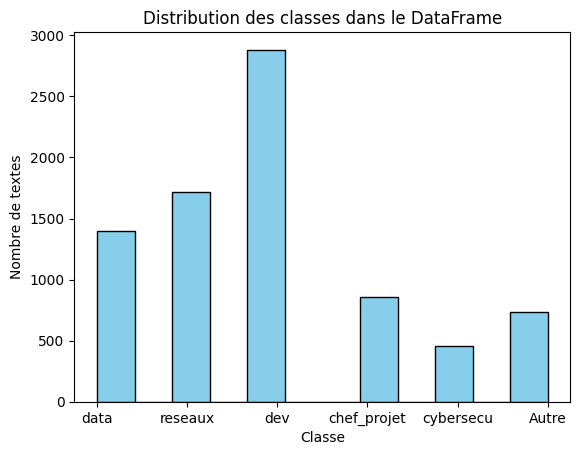

In [56]:

#plt.figure(figsize=(6, 4))  
plt.hist(ML_df['label'], bins=12, color='skyblue', edgecolor='black')  # Définir le nombre de bacs et les couleurs
plt.title('Distribution des classes dans le DataFrame')  # Ajouter un titre au graphique
plt.xlabel('Classe')  # Ajouter une étiquette pour l'axe x
plt.ylabel('Nombre de textes')  # Ajouter une étiquette pour l'axe y
plt.xticks([0, 1 , 2 , 3 , 4 , 5], labels= ["data" , "reseaux" , "dev" , "chef_projet" , "cybersecu" , "Autre"])  # Définir les étiquettes de l'axe x
plt.show()

*   Suppression de le ponctuation, des chiffres et des stop-words

In [57]:
f = lambda doc: remove_stopwords_Fr_2(remove_numbers(remove_ponctuation(doc)) ) 
tf_idf_vectorizer = TfidfVectorizer(preprocessor=f, max_features=1000)
X = tfidf_vectorizer.fit_transform(ML_df['descriptif_poste'])

In [58]:
X_train, X_test, y_train, y_test = train_test_split(X, df['label'], test_size=0.2, random_state=42)

# RandomForestClassifier
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier.fit(X_train, y_train)
y_pred = rf_classifier.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("RandomForest Accuracy:", accuracy)

# SVC
svm_classifier = SVC(kernel='linear', random_state=42)
svm_classifier.fit(X_train, y_train)
y_pred_svm = svm_classifier.predict(X_test)
accuracy_svm = accuracy_score(y_test, y_pred_svm)
print("SVM Accuracy:", accuracy_svm)

# MultinomialNB
nb_classifier = MultinomialNB()
nb_classifier.fit(X_train, y_train)
y_pred_nb = nb_classifier.predict(X_test)
accuracy_nb = accuracy_score(y_test, y_pred_nb)
print("Naive Bayes Accuracy:", accuracy_nb)

RandomForest Accuracy: 0.7414543194530765
SVM Accuracy: 0.7364822871348664
Naive Bayes Accuracy: 0.6836544437538844


*   Lemmatisation de le ponctuation, des chiffres et des stop-words

In [59]:
f = lambda doc: lemmatization(remove_stopwords_Fr_2(remove_numbers(remove_ponctuation(doc)) ) )
tf_idf_vectorizer = TfidfVectorizer(preprocessor=f, max_features=1000)
X = tfidf_vectorizer.fit_transform(ML_df['descriptif_poste'])

In [60]:
X_train, X_test, y_train, y_test = train_test_split(X, df['label'], test_size=0.2, random_state=42)

# RandomForestClassifier
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier.fit(X_train, y_train)
y_pred = rf_classifier.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("RandomForest Accuracy:", accuracy)

# SVC
svm_classifier = SVC(kernel='linear', random_state=42)
svm_classifier.fit(X_train, y_train)
y_pred_svm = svm_classifier.predict(X_test)
accuracy_svm = accuracy_score(y_test, y_pred_svm)
print("SVM Accuracy:", accuracy_svm)

# MultinomialNB
nb_classifier = MultinomialNB()
nb_classifier.fit(X_train, y_train)
y_pred_nb = nb_classifier.predict(X_test)
accuracy_nb = accuracy_score(y_test, y_pred_nb)
print("Naive Bayes Accuracy:", accuracy_nb)

RandomForest Accuracy: 0.7414543194530765
SVM Accuracy: 0.7364822871348664
Naive Bayes Accuracy: 0.6836544437538844


*   Stemming de le ponctuation, des chiffres et des stop-words

In [61]:
f = lambda doc: stemming_Fr(remove_stopwords_Fr_2(remove_numbers(remove_ponctuation(doc)) ) )
tf_idf_vectorizer = TfidfVectorizer(preprocessor=f, max_features=1000)
X = tfidf_vectorizer.fit_transform(ML_df['descriptif_poste'])

In [62]:

# RandomForestClassifier
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier.fit(X_train, y_train)
y_pred = rf_classifier.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("RandomForest Accuracy:", accuracy)

# SVC
svm_classifier = SVC(kernel='linear', random_state=42)
svm_classifier.fit(X_train, y_train)
y_pred_svm = svm_classifier.predict(X_test)
accuracy_svm = accuracy_score(y_test, y_pred_svm)
print("SVM Accuracy:", accuracy_svm)

# MultinomialNB
nb_classifier = MultinomialNB()
nb_classifier.fit(X_train, y_train)
y_pred_nb = nb_classifier.predict(X_test)
accuracy_nb = accuracy_score(y_test, y_pred_nb)
print("Naive Bayes Accuracy:", accuracy_nb)

RandomForest Accuracy: 0.7414543194530765
SVM Accuracy: 0.7364822871348664
Naive Bayes Accuracy: 0.6836544437538844


In [20]:
tfidf_vectorizer = TfidfVectorizer(max_features=1000)
X = tfidf_vectorizer.fit_transform(ML_df['descriptif_poste']) 

X_train, X_test, y_train, y_test = train_test_split(X, df['label'], test_size=0.2, random_state=42)

rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier.fit(X_train, y_train)
y_pred_rf = rf_classifier.predict(X_test)
print("RandomForest Classification Report :")
print(classification_report(y_test, y_pred_rf))

RandomForest Classification Report :
              precision    recall  f1-score   support

           0       0.75      0.84      0.79       289
           1       0.72      0.81      0.76       336
           2       0.72      0.85      0.78       572
           3       0.73      0.42      0.53       164
           4       0.86      0.66      0.74        82
           5       0.89      0.43      0.58       166

    accuracy                           0.74      1609
   macro avg       0.78      0.67      0.70      1609
weighted avg       0.75      0.74      0.73      1609



D'aprés c'est résultat on peut tirer les colclusions suivantes :

    *   Le meilleur modele de classification entre les 3 c'est le RandomForestClassifier avec une accuracy de 0.74
    *   Les fonctions qui permettent de nettoyer les données n'ont pas augmenté les performences des modéles
    *   Il faut noté que nos classes sont déséquilibrées ce qui veut dire que l'accuracy ne permet pas vraiment de donner une idée sur la performance de notre modéle.
    *   Pour gérer le déséquilibre de classes dans votre problème de classification multi-classe en NLP, nous allons utiliser les différentes techniques suivantes

## Ré-échantillonnage des données 

Il existe pulsieurs methodes afin de ré-échantillonner nos données :

- Suréchantillonnage (oversampling) : Répliquer aléatoirement des exemples de la classe minoritaire.
- Sous-échantillonnage (undersampling) : Supprimer aléatoirement des exemples de la classe majoritaire.
- Utilisation de méthodes comme SMOTE (Synthetic Minority Over-sampling Technique) pour générer des exemples synthétiques de la classe minoritaire.

In [14]:
tfidf_vectorizer = TfidfVectorizer(max_features=1000)
X = tfidf_vectorizer.fit_transform(ML_df['descriptif_poste'])

In [15]:
X_train, X_test, y_train, y_test = train_test_split(X, df['label'], test_size=0.2, random_state=42)

*   OverSampling

In [17]:
ros = RandomOverSampler(random_state=42)
X_resampled, y_resampled = ros.fit_resample(X_train, y_train)

rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier.fit(X_resampled, y_resampled)

y_pred_rf = rf_classifier.predict(X_test)
print("RandomForest Classification Report after oversampling :")
print(classification_report(y_test, y_pred_rf))

RandomForest Classification Report after oversampling :
              precision    recall  f1-score   support

           0       0.76      0.86      0.80       289
           1       0.72      0.81      0.76       336
           2       0.80      0.80      0.80       572
           3       0.72      0.57      0.63       164
           4       0.75      0.76      0.75        82
           5       0.79      0.57      0.66       166

    accuracy                           0.76      1609
   macro avg       0.75      0.73      0.73      1609
weighted avg       0.76      0.76      0.76      1609



* UnderSampling

In [18]:
rus = RandomUnderSampler(random_state=42)
X_resampled_2, y_resampled_2 = rus.fit_resample(X_train, y_train)

rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier.fit(X_resampled_2, y_resampled_2)

y_pred_rf = rf_classifier.predict(X_test)
print("RandomForest Classification Report after undersampling :")
print(classification_report(y_test, y_pred_rf))

RandomForest Classification Report after undersampling :
              precision    recall  f1-score   support

           0       0.68      0.84      0.75       289
           1       0.68      0.67      0.68       336
           2       0.85      0.61      0.71       572
           3       0.57      0.60      0.58       164
           4       0.53      0.93      0.68        82
           5       0.55      0.65      0.59       166

    accuracy                           0.68      1609
   macro avg       0.64      0.72      0.66      1609
weighted avg       0.71      0.68      0.68      1609



*   SMOTE

In [19]:
smote = SMOTE(random_state=42)
X_resampled_3, y_resampled_3 = smote.fit_resample(X_train, y_train)

rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier.fit(X_resampled_3, y_resampled_3)

y_pred_rf = rf_classifier.predict(X_test)
print("RandomForest Classification Report after SMOTE :")
print(classification_report(y_test, y_pred_rf))

RandomForest Classification Report after SMOTE :
              precision    recall  f1-score   support

           0       0.74      0.87      0.80       289
           1       0.71      0.79      0.75       336
           2       0.77      0.77      0.77       572
           3       0.72      0.54      0.62       164
           4       0.80      0.79      0.80        82
           5       0.74      0.54      0.62       166

    accuracy                           0.75      1609
   macro avg       0.75      0.72      0.73      1609
weighted avg       0.75      0.75      0.74      1609



## Pondération des classes 

Utilisation des paramètres de pondération des classes 

In [23]:
# Calculer les poids de classe pour la pondération
class_weights = class_weight.compute_class_weight('balanced', classes=np.unique(y_train), y=y_train)

# RandomForestClassifier avec pondération de classe
rf_classifier = RandomForestClassifier(n_estimators=100, class_weight=dict(enumerate(class_weights)), random_state=42)
rf_classifier.fit(X_train, y_train)
y_pred_rf = rf_classifier.predict(X_test)
print("RandomForest Classification Report after SMOTE :")
print(classification_report(y_test, y_pred_rf))


RandomForest Classification Report after SMOTE :
              precision    recall  f1-score   support

           0       0.75      0.85      0.80       289
           1       0.73      0.77      0.75       336
           2       0.71      0.83      0.77       572
           3       0.72      0.45      0.55       164
           4       0.78      0.70      0.74        82
           5       0.83      0.43      0.56       166

    accuracy                           0.74      1609
   macro avg       0.75      0.67      0.69      1609
weighted avg       0.74      0.74      0.73      1609

